# **MODERN COMPUTER VISION** #
##### BY RAJEEV RATAN

<h2 style="margin-bottom:0;">🚀 Neural Style Transfer with OpenCV</h2>

<h5 style="margin-top:5px;">In this lesson we'll learn how to use pre-trained Models to implement Neural Style Transfer in OpenCV.</h5>

In [3]:
# Our Setup, Import Libraries and Create our Imshow Function
import numpy as np
import cv2
import time
import os
from os import listdir
from os.path import isfile, join
from matplotlib import pyplot as plt

# Define our imshow function
def imshow(title = "Image", image = None, size = 10):
    w, h = image.shape[0], image.shape[1]
    aspect_ratio = w/h
    plt.figure(figsize=(size * aspect_ratio, size))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title(title)
    plt.show()

!gdown --id 1PXvNLCUxQYx-15S6FnpcnpRLGxp14Ys_
!unzip -qq NeuralStyleTransfer.zip

/home/robin/Self-learning/Tutorialspoint_Artificial_Intelligence_and_Machine_Learning_Certification_2026/Module_4_Modern_Computer_Vision/OpenCV/.venv/lib/python3.12/site-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1PXvNLCUxQYx-15S6FnpcnpRLGxp14Ys_
From (redirected): https://drive.google.com/uc?id=1PXvNLCUxQYx-15S6FnpcnpRLGxp14Ys_&confirm=t&uuid=a4ee8565-a170-4d11-a0ab-651f02f5c57f
To: /home/robin/Self-learning/Tutorialspoint_Artificial_Intelligence_and_Machine_Learning_Certification_2026/Module_4_Modern_Computer_Vision/OpenCV/8.OpenCV_Projects/NeuralStyleTransfer.zip
100%|████████████████████████████████████████| 187M/187M [00:24<00:00, 7.68MB/s]


In [4]:
!wget https://github.com/rajeevratan84/ModernComputerVision/raw/main/city.jpg

--2026-01-11 16:47:42--  https://github.com/rajeevratan84/ModernComputerVision/raw/main/city.jpg
Resolving github.com (github.com)... 20.205.243.166
Connecting to github.com (github.com)|20.205.243.166|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/rajeevratan84/ModernComputerVision/main/city.jpg [following]
--2026-01-11 16:47:42--  https://raw.githubusercontent.com/rajeevratan84/ModernComputerVision/main/city.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.110.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.111.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 392132 (383K) [image/jpeg]
Saving to: ‘city.jpg’

city.jpg            100%[===================>] 382.94K  --.-KB/s    in 0.06s   

2026-01-11 16:47:43 (6.46 MB/s) - ‘city.jpg’ saved [392132/392132]



### **Implement Neural Style Transfer using pretrained Models** ###

1. Using Model: the_scream


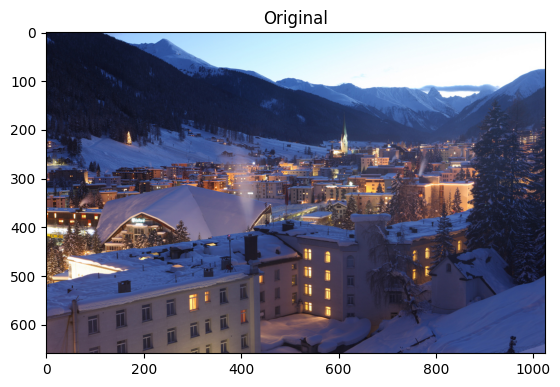

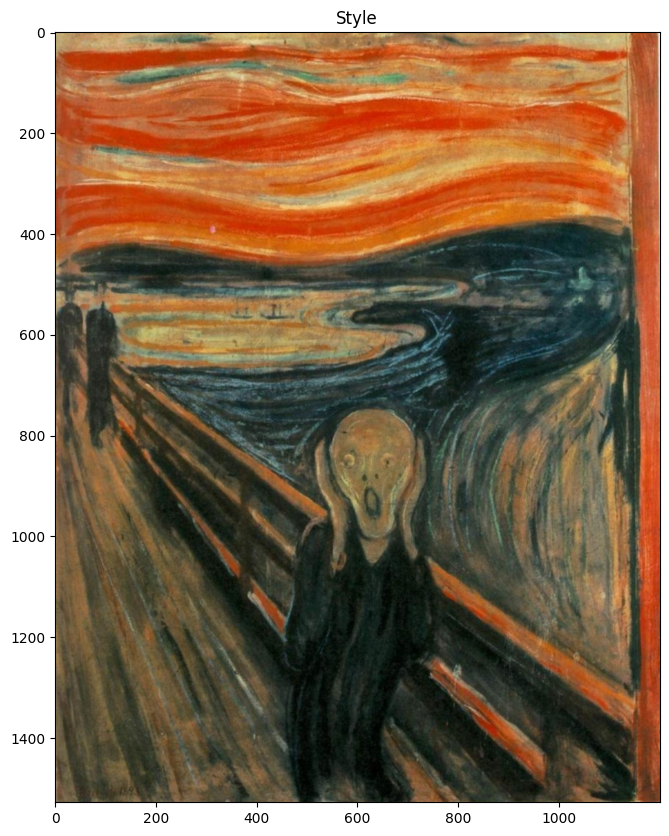

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.12001137..1.0299027].


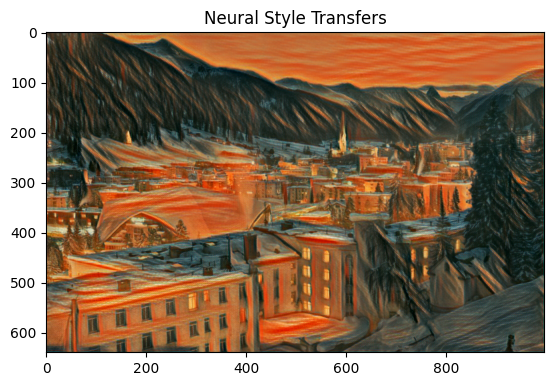

2. Using Model: feathers


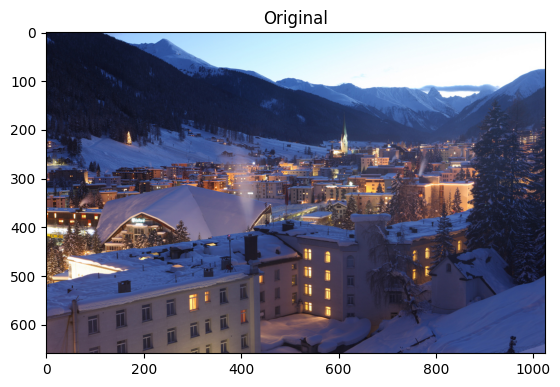

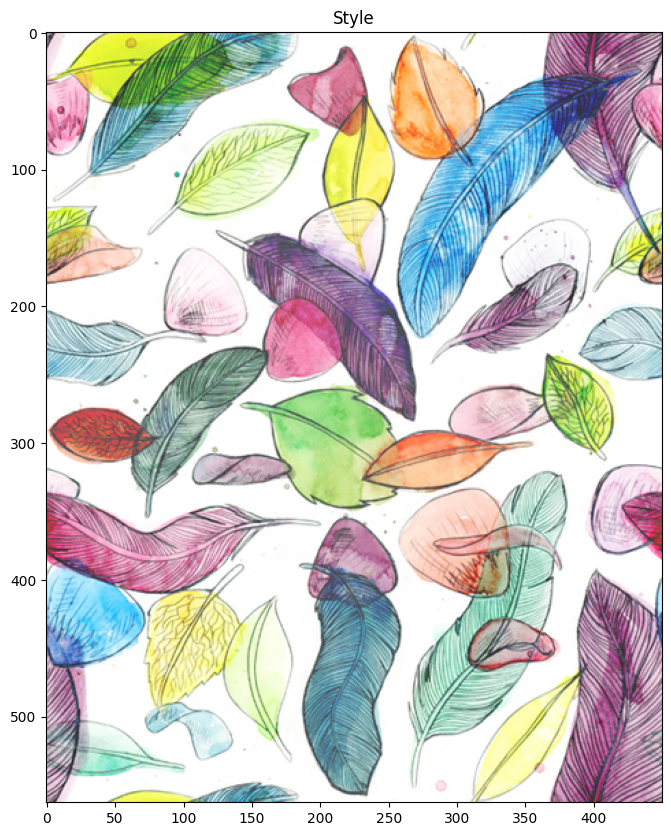

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.13316767..1.0731907].


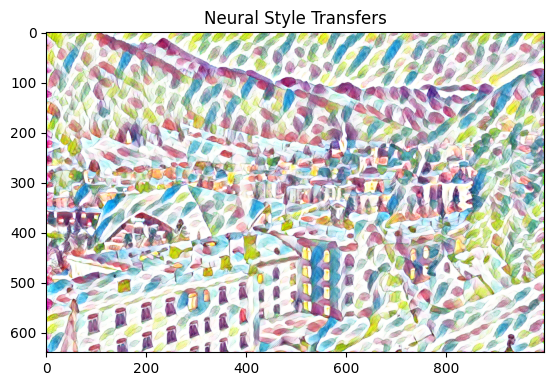

3. Using Model: the_wave


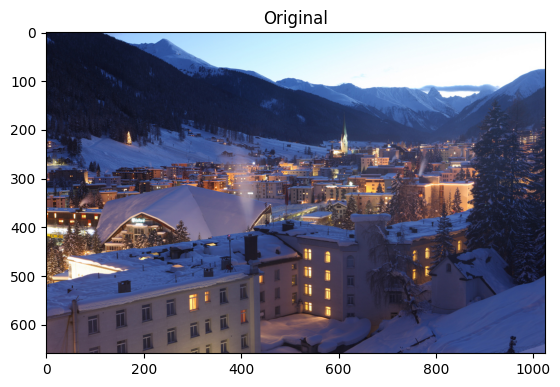

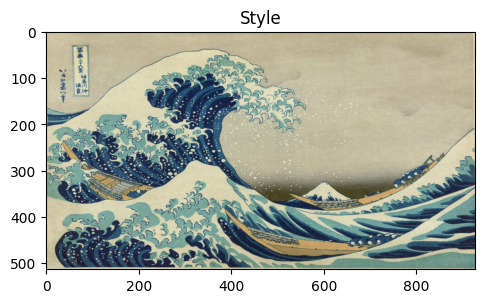

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.028701393..1.0730054].


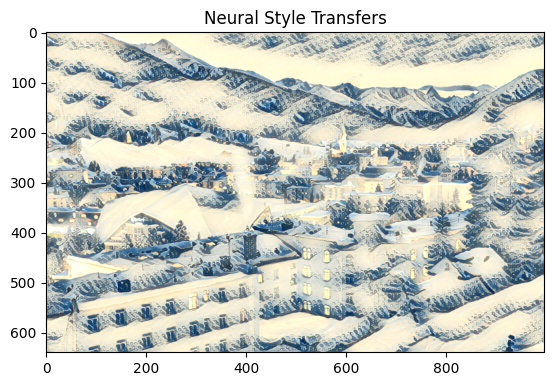

4. Using Model: composition_vii


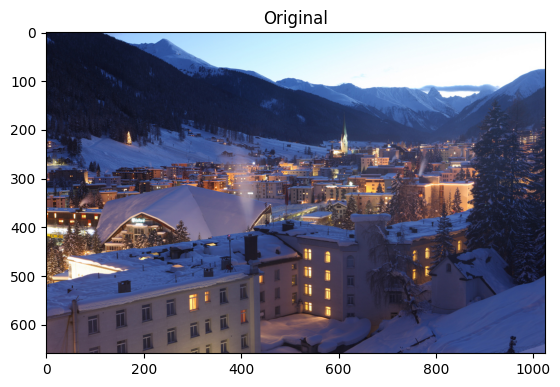

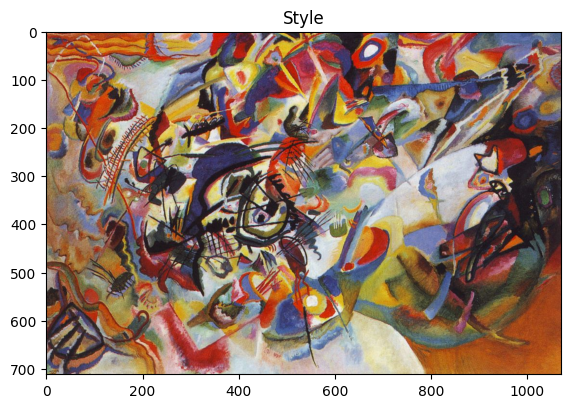

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.16784582..1.0649363].


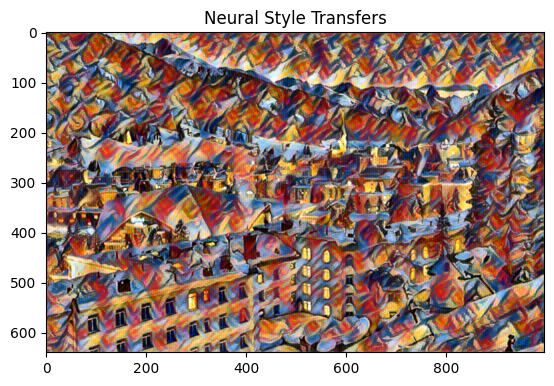

5. Using Model: candy


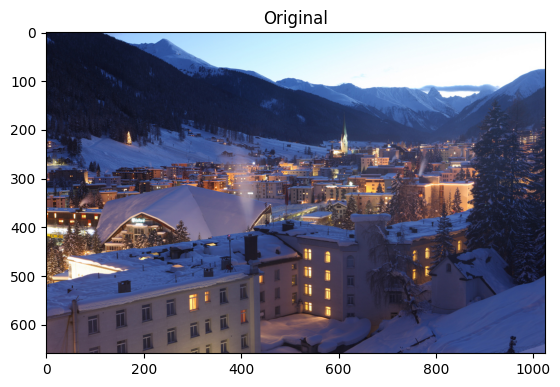

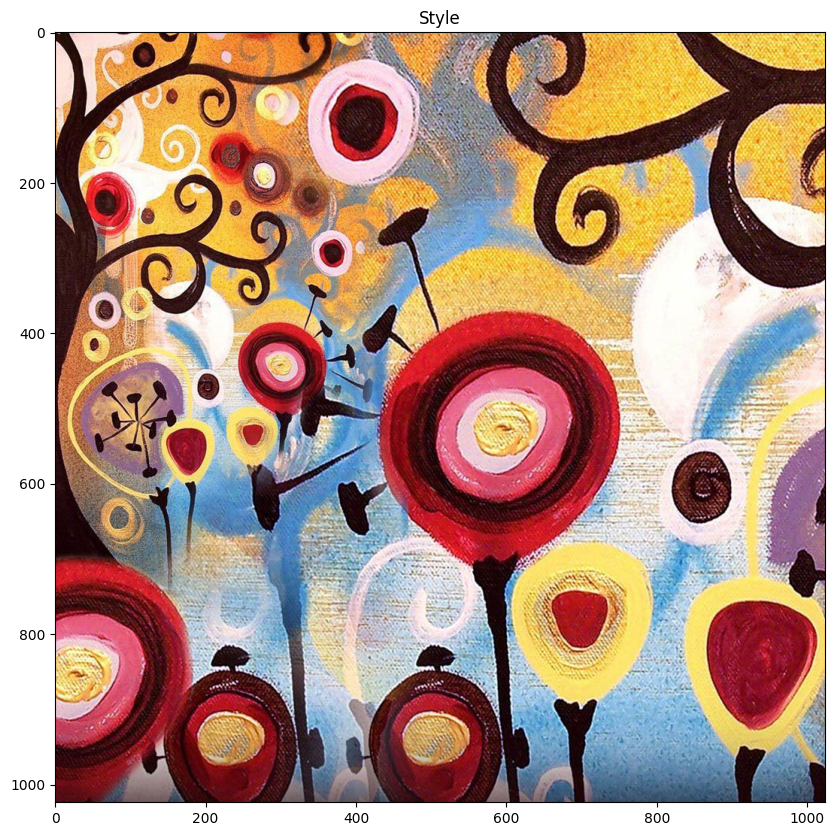

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.14600767..1.0692179].


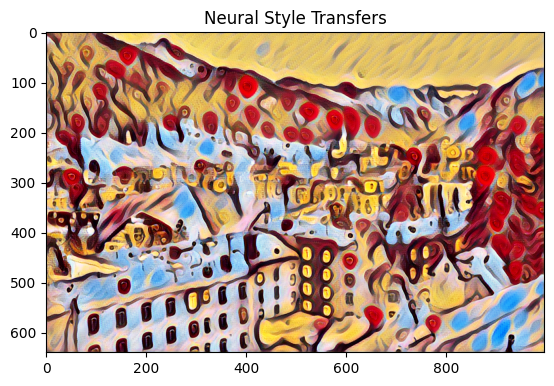

6. Using Model: udnie


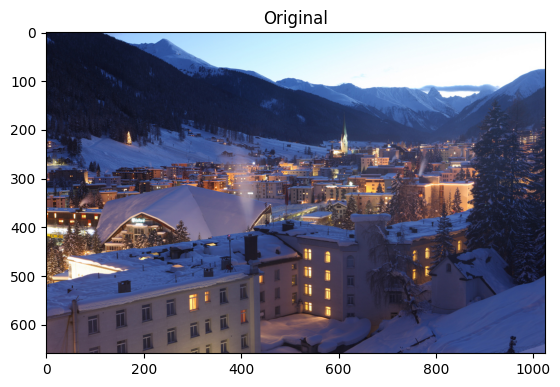

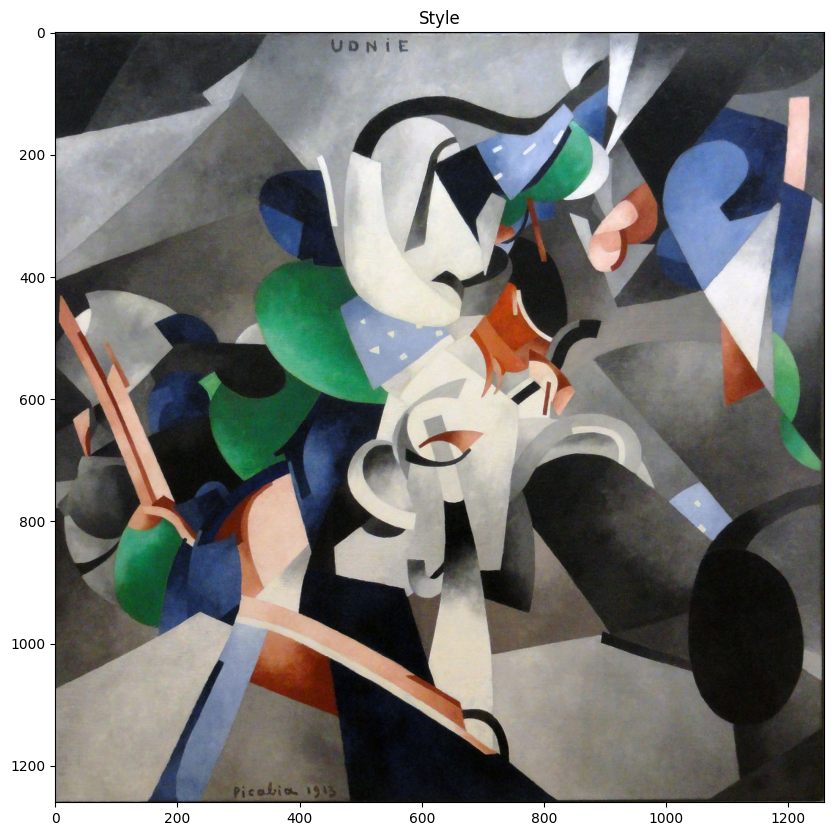

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.16184665..1.0599415].


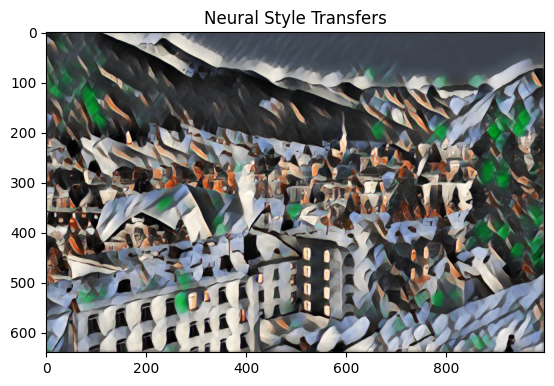

7. Using Model: starry_night


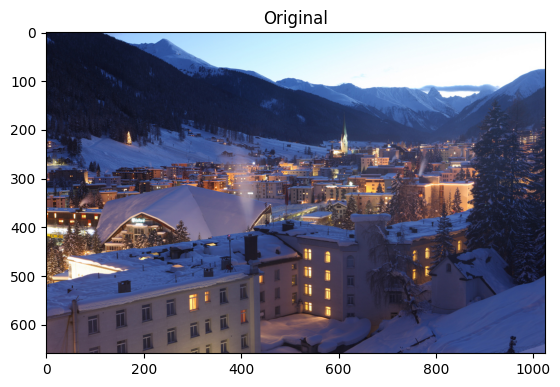

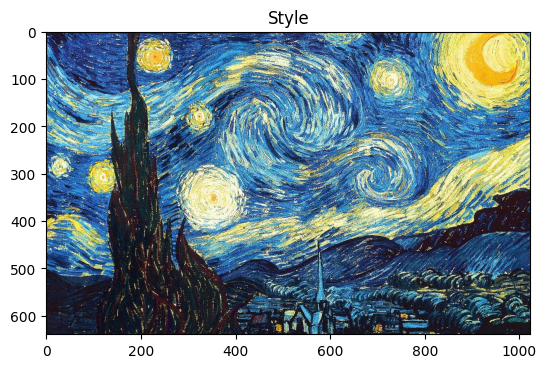

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.10886012..1.0704789].


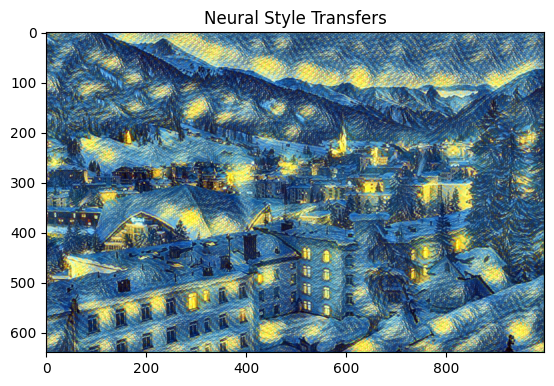

8. Using Model: mosaic


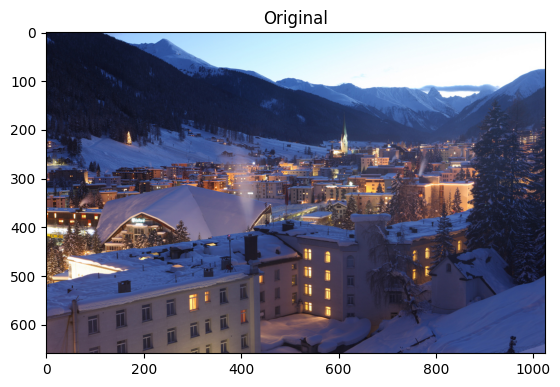

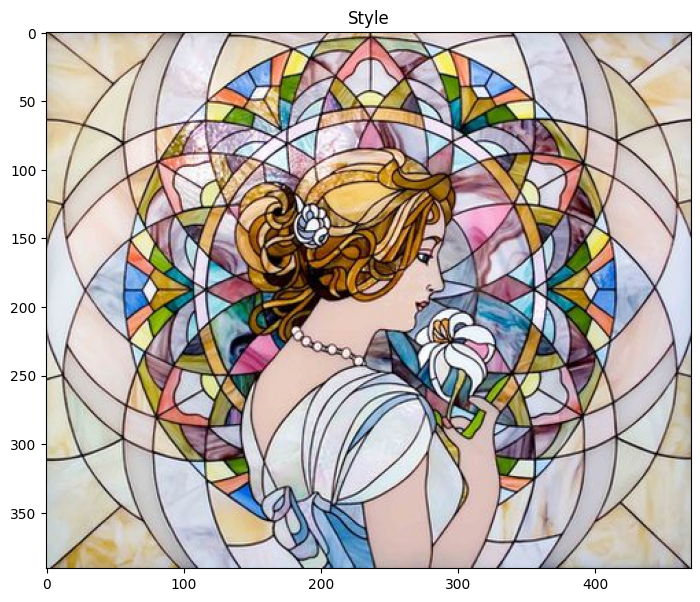

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.15099902..1.0575643].


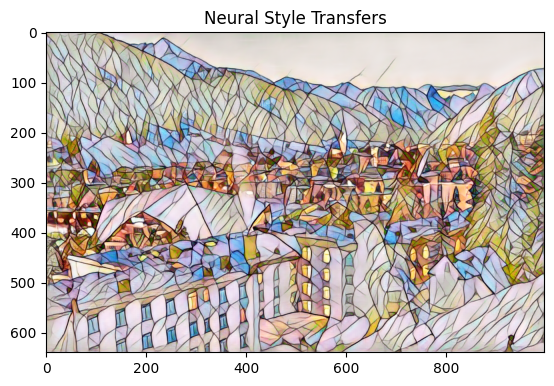

9. Using Model: la_muse


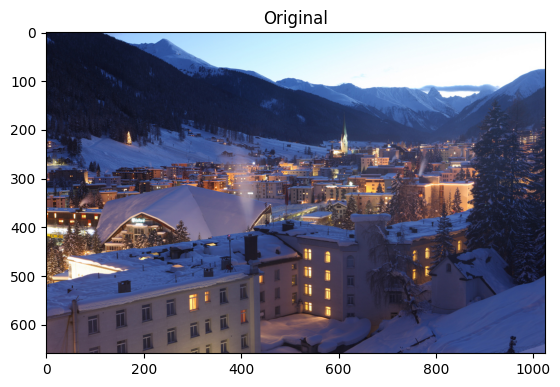

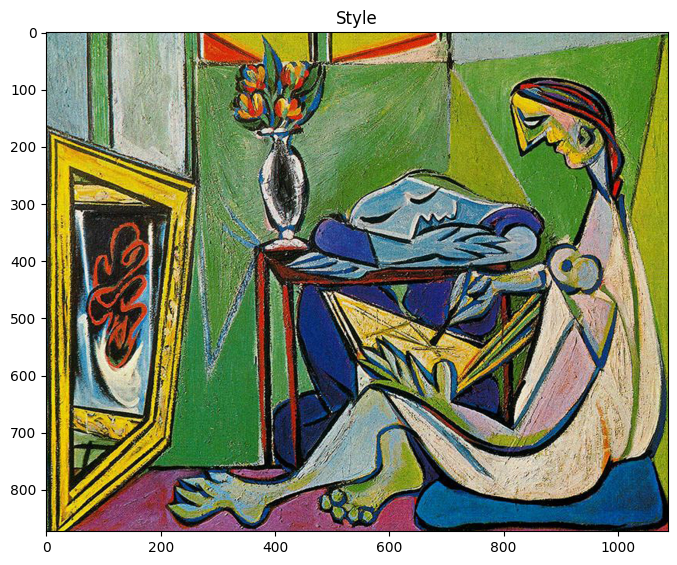

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.17889348..1.0717961].


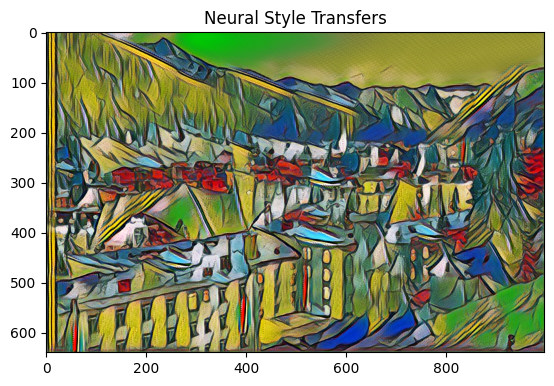

In [6]:
# Load our t7 neural transfer models
model_file_path = "../NeuralStyleTransfer/models/"
model_file_paths = [f for f in listdir(model_file_path) if isfile(join(model_file_path, f))]

# Load our test image
img = cv2.imread("../images/city.jpg")

# Loop through and applying each model style to our input image
for (i, model) in enumerate(model_file_paths):
    # print the model being used
    print(str(i+1) + ". Using Model: " + str(model)[:-3])
    style = cv2.imread("../NeuralStyleTransfer/art/" + str(model)[:-3] + ".jpg")
    # loading our neural style transfer model
    neuralStyleModel = cv2.dnn.readNetFromTorch(model_file_path + model)

    # Let's resize to a fixed height of 640 (feel free to change)
    height, width = int(img.shape[0]), int(img.shape[1])
    newWidth = int((640 / height) * width)
    resizedImg = cv2.resize(img, (newWidth, 640), interpolation = cv2.INTER_AREA)

    # Create our blob from the image and then perform a forward pass run of the network
    inpBlob = cv2.dnn.blobFromImage(resizedImg, 1.0, (newWidth, 640), (103.939, 116.779, 123.68), swapRB=False, crop=False)

    neuralStyleModel.setInput(inpBlob)
    output = neuralStyleModel.forward()

    # Reshaping the output tensor, adding back the mean subtraction and re-ordering the channels
    output = output.reshape(3, output.shape[2], output.shape[3])
    output[0] += 103.939
    output[1] += 116.779
    output[2] += 123.68
    output /= 255
    output = output.transpose(1, 2, 0)

    # Display our original image, the tyle being applied and the final Neural Style Transfer
    imshow("Original", img)
    imshow("Style", style)
    imshow("Neural Style Transfers", output)

## **Using the ECCV16 Updated NST Algorithm** ##

1. Using Model: the_wave


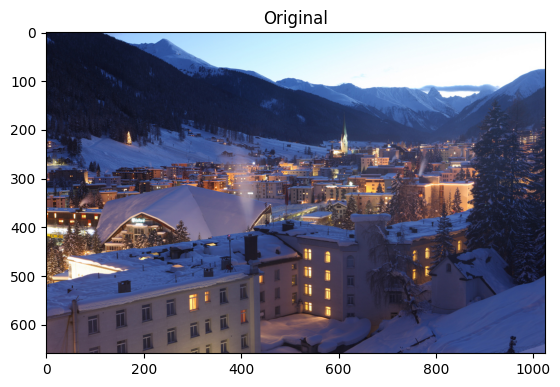

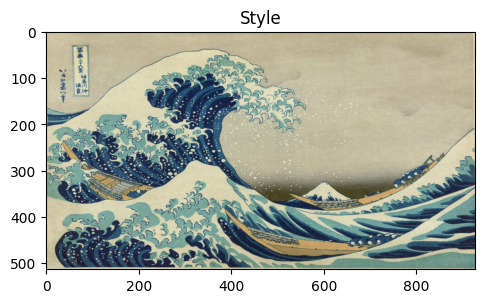

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.028701393..1.0730054].


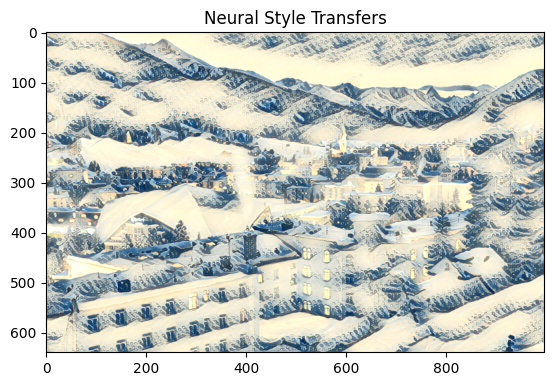

2. Using Model: composition_vii


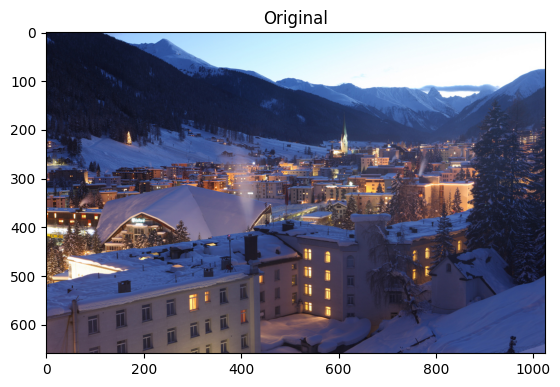

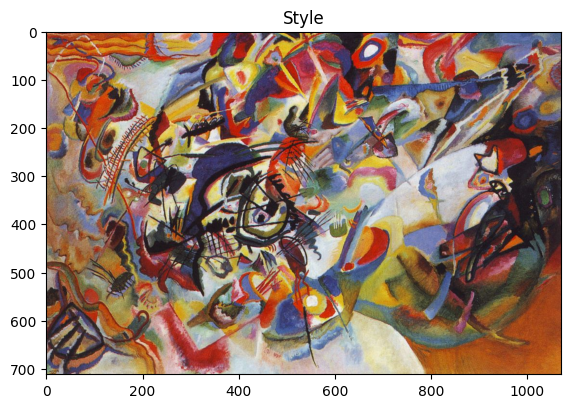

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.16784582..1.0649363].


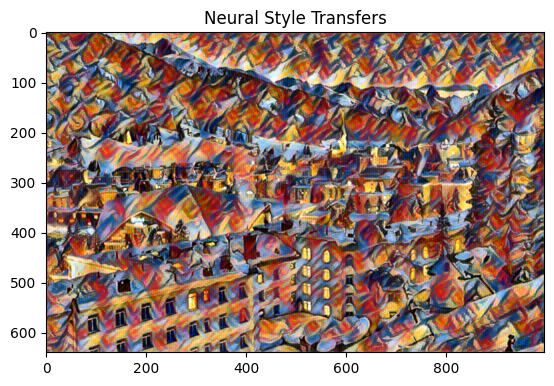

3. Using Model: starry_night


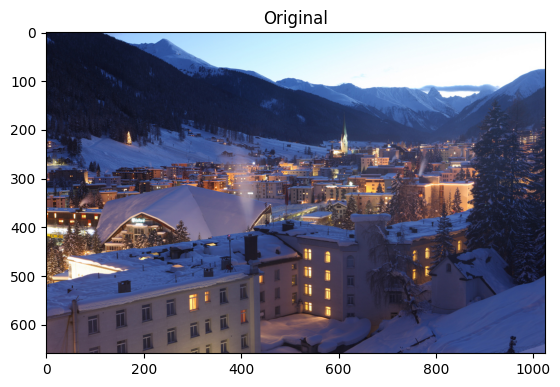

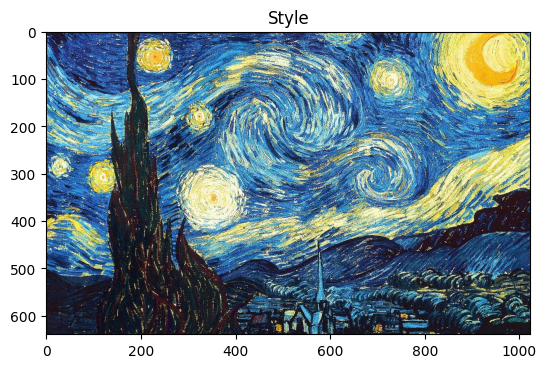

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.16086884..1.0732079].


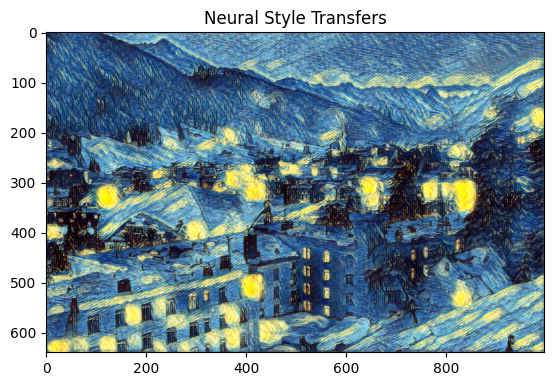

4. Using Model: la_muse


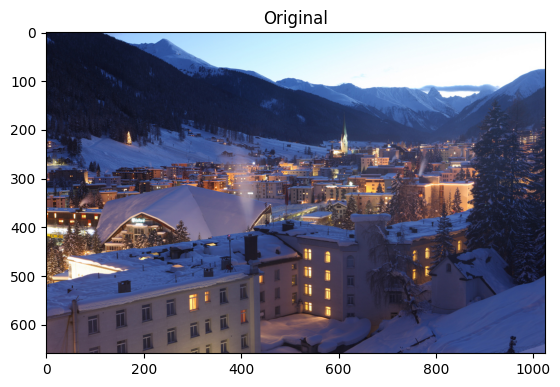

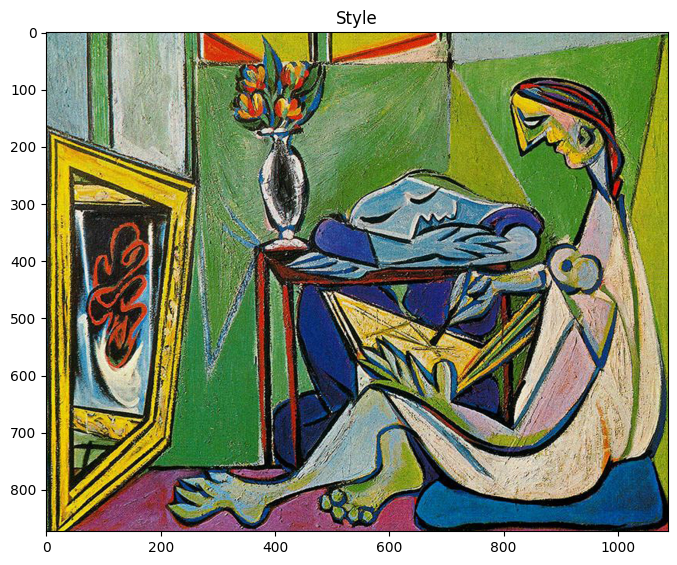

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.17889348..1.0717961].


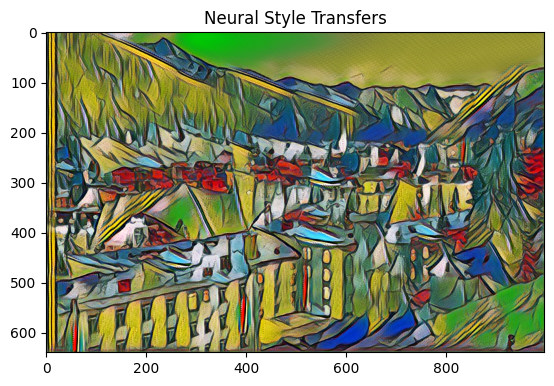

In [7]:
# Load our t7 neural transfer models
model_file_path = "../NeuralStyleTransfer/models/ECCV16/"
model_file_paths = [f for f in listdir(model_file_path) if isfile(join(model_file_path, f))]

# Load our test image
img = cv2.imread("../images/city.jpg")

# Loop through and applying each model style to our input image
for (i, model) in enumerate(model_file_paths):
    # print the model being used
    print(str(i+1) + ". Using Model: " + str(model)[:-3])
    style = cv2.imread("../NeuralStyleTransfer/art/" + str(model)[:-3] + ".jpg")
    # loading our neural style transfer model
    neuralStyleModel = cv2.dnn.readNetFromTorch(model_file_path + model)

    # Let's resize to a fixed height of 640 (feel free to change)
    height, width = int(img.shape[0]), int(img.shape[1])
    newWidth = int((640 / height) * width)
    resizedImg = cv2.resize(img, (newWidth, 640), interpolation = cv2.INTER_AREA)

    # Create our blob from the image and then perform a forward pass run of the network
    inpBlob = cv2.dnn.blobFromImage(resizedImg, 1.0, (newWidth, 640), (103.939, 116.779, 123.68), swapRB=False, crop=False)

    neuralStyleModel.setInput(inpBlob)
    output = neuralStyleModel.forward()

    # Reshaping the output tensor, adding back the mean subtraction and re-ordering the channels
    output = output.reshape(3, output.shape[2], output.shape[3])
    output[0] += 103.939
    output[1] += 116.779
    output[2] += 123.68
    output /= 255
    output = output.transpose(1, 2, 0)

    # Display our original image, the tyle being applied and the final Neural Style Transfer
    imshow("Original", img)
    imshow("Style", style)
    imshow("Neural Style Transfers", output) 


In [8]:
!wget https://github.com/rajeevratan84/ModernComputerVision/raw/main/dj.mp4

--2026-01-11 17:36:33--  https://github.com/rajeevratan84/ModernComputerVision/raw/main/dj.mp4
Resolving github.com (github.com)... 20.205.243.166
Connecting to github.com (github.com)|20.205.243.166|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/rajeevratan84/ModernComputerVision/main/dj.mp4 [following]
--2026-01-11 17:36:33--  https://raw.githubusercontent.com/rajeevratan84/ModernComputerVision/main/dj.mp4
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.108.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 174741 (171K) [application/octet-stream]
Saving to: ‘dj.mp4’

dj.mp4              100%[===================>] 170.65K  --.-KB/s    in 0.05s   

2026-01-11 17:36:33 (3.45 MB/s) - ‘dj.mp4’ saved [174741/174741]



In [9]:
# Load our t7 neural transfer models
model_file_path = "../NeuralStyleTransfer/models/ECCV16/starry_night.t7"

# Load video stream, long clip
cap = cv2.VideoCapture('../videos/dj.mp4')

# Get the height and width of the frame (required to be an integer)
w = int(cap.get(3))
h = int(cap.get(4))

# Define the codec and create VideoWriter object. The output is stored in '*.avi' file
out = cv2.VideoWriter('../videos/NST_Starry_Night.avi', cv2.VideoWriter_fourcc('M', 'J', 'P', 'G'), 30, (w, h))

# Loop through and applying each model style to our input image
style = cv2.imread("../NeuralStyleTransfer/art/starry_night.jpg")
i = 0
while(1):

    ret, img = cap.read()

    if ret == True:
        i += 1
        print("Completed {} Frame(s)".format(i))
        # loading our neural style transfer model
        neuralStyleModel = cv2.dnn.readNetFromTorch(model_file_path)

        # Let's resize to a fixed height of 640 (feel free to change)
        height, width = int(img.shape[0]), int(img.shape[1])
        newWidth = int((640 / height) * width)
        resizedImg = cv2.resize(img, (newWidth, 640), interpolation = cv2.INTER_AREA)

        # Create our blob from the image and then perform a forward pass run of the network
        inpBlob = cv2.dnn.blobFromImage(resizedImg, 1.0, (newWidth, 640), 
                                        (103.939, 116.779, 123.68), swapRB=False, crop=False)

        neuralStyleModel.setInput(inpBlob)
        output = neuralStyleModel.forward()

        # Reshaping the output tensor, adding back the mean subtraction 
        # and re-ordering the channels
        output = output.reshape(3, output.shape[2], output.shape[3])
        output[0] += 103.939
        output[1] += 116.779
        output[2] += 123.68
        output /= 255
        output = output.transpose(1, 2, 0)
        
        # Display our original image, the style being applied and the final Neural Style Transfer
        vid_output = (output * 255).astype(np.uint8)
        vid_output = cv2.resize(vid_output, (w, h), interpolation = cv2.INTER_AREA)
        out.write(vid_output)
    else:
        break

cap.release()
out.release()

Completed 1 Frame(s)
Completed 2 Frame(s)
Completed 3 Frame(s)
Completed 4 Frame(s)
Completed 5 Frame(s)
Completed 6 Frame(s)
Completed 7 Frame(s)
Completed 8 Frame(s)
Completed 9 Frame(s)
Completed 10 Frame(s)
Completed 11 Frame(s)
Completed 12 Frame(s)
Completed 13 Frame(s)
Completed 14 Frame(s)
Completed 15 Frame(s)
Completed 16 Frame(s)
Completed 17 Frame(s)
Completed 18 Frame(s)
Completed 19 Frame(s)
Completed 20 Frame(s)
Completed 21 Frame(s)
Completed 22 Frame(s)
Completed 23 Frame(s)
Completed 24 Frame(s)
Completed 25 Frame(s)
Completed 26 Frame(s)
Completed 27 Frame(s)
Completed 28 Frame(s)
Completed 29 Frame(s)
Completed 30 Frame(s)
Completed 31 Frame(s)
Completed 32 Frame(s)
Completed 33 Frame(s)


In [12]:
!ffmpeg -i ../videos/NST_Starry_Night.avi ../videos/NST_Starry_Night.mp4 -y

ffmpeg version 6.1.1-3ubuntu5 Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 13 (Ubuntu 13.2.0-23ubuntu3)
  configuration: --prefix=/usr --extra-version=3ubuntu5 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --disable-omx --enable-gnutls --enable-libaom --enable-libass --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libglslang --enable-libgme --enable-libgsm --enable-libharfbuzz --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg --ena

In [13]:
from IPython.display import HTML
import base64

video_path = "../videos/NST_Starry_Night.mp4"

with open(video_path, "rb") as f:
    video_data = f.read()
encoded = base64.b64encode(video_data).decode("utf-8")

HTML(f"""
<video width="600" controls>
    <source src="data:video/mp4;base64,{encoded}" type="video/mp4">
</video>
""")

### **Want to train your own NST Model?** ###
### **Look at later sections of the course where we take a look at implementing our very own Deep** ###
### **Learning NST Algorithm** ###

##### Alternatively, give this github repo a shot and try it yourself - https://github.com/jcjohnson/fast-neural-style #####